# FEA Bending Modes

In [1]:
import numpy as np
import pandas as pd
import scipy.io

import matplotlib.pyplot as plt
from M1S_tools import *

plt.jet()

%matplotlib inline

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
## bending modes & influence matrices etc from Buddy #####################
ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991
## bending modes & influence matrices etc from Trupti #####################
N actuators =  170
Afz =  (27685, 170)
Afx =  (27685, 170)
Afy =  (27685, 170)
U matrix (27685, 170)
V matrix (170, 170)
S matrix (170, 170)
N node =  27685


<Figure size 640x480 with 0 Axes>

In [9]:
#data from Christoph
dataFolderC = '/Users/bxin/GMT_docs/1_M1/Data/20230925_1818_M1S1_testCell'

mat = scipy.io.loadmat(dataFolderC+'/bending modes actuator axial force.mat')
mat1 = scipy.io.loadmat(dataFolderC+'/useful datasets.mat')
mat2 = scipy.io.loadmat(dataFolderC+'/model.mat')

/Users/bxin/opt/miniconda3/envs/p3/lib/python3.11/site-packages/scipy/io/matlab/_mio.py:227: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [10]:
print(mat.keys())
print(mat1.keys())
print(mat2.keys())

dict_keys(['__header__', '__version__', '__globals__', 'Force', 'Z', 'actuatorForces', 'None', 'bendingModes', 'compliance', 'singularValues', '__function_workspace__'])
dict_keys(['__header__', '__version__', '__globals__', 'None', 'rbmM1B12elongations', '__function_workspace__'])
dict_keys(['__header__', '__version__', '__globals__', 'modelStr', 'None', '__function_workspace__'])


In [5]:
mat['bendingModes'].shape

(28789, 162)

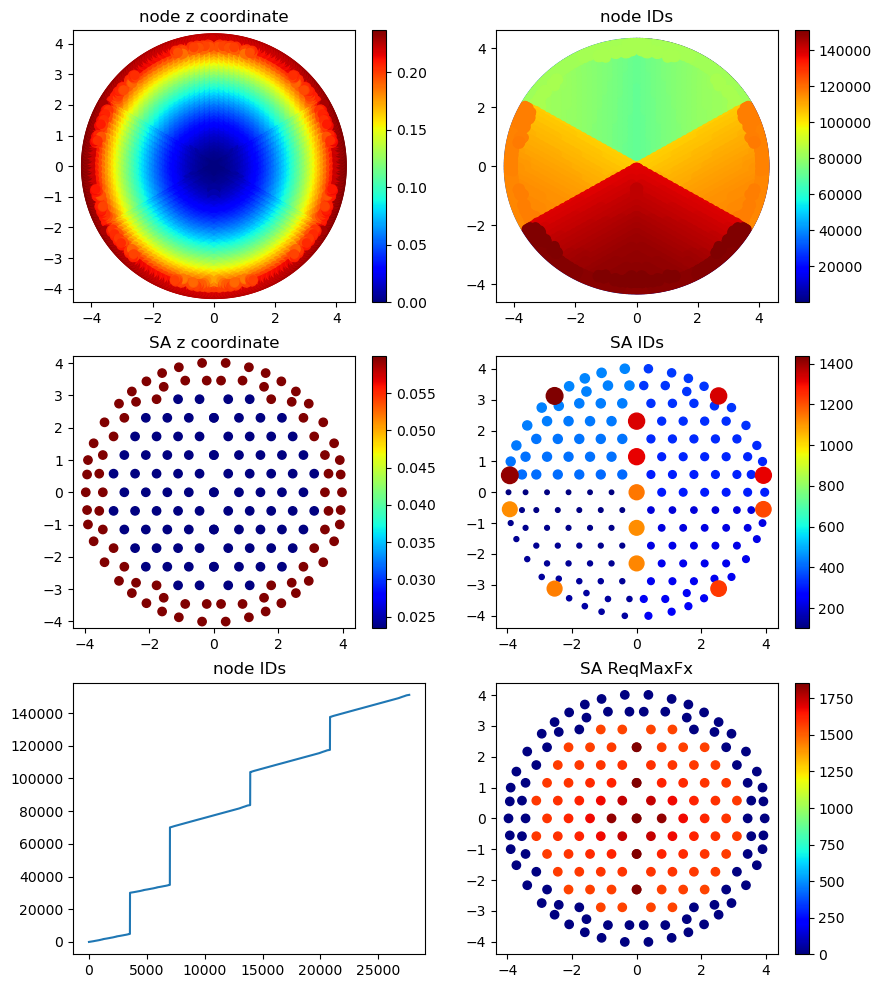

In [3]:
fig, ax = plt.subplots(3,2, figsize=(10,12))
img = ax[0][0].scatter(nodex, nodey, c=nodez)
fig.colorbar(img, ax=ax[0][0])
img = ax[0][1].scatter(nodex, nodey, c=nodeID)
fig.colorbar(img, ax=ax[0][1])
img = ax[1][1].scatter(sax, say, saID*0.1, c=saID)
fig.colorbar(img, ax=ax[1][1])
img = ax[1][0].scatter(sax, say, c=saz)
fig.colorbar(img, ax=ax[1][0])
img = ax[2][1].scatter(sax, say, c=saReqMaxFx_N)
fig.colorbar(img, ax=ax[2][1])
ax[2][0].plot(nodeID)
ax[0][0].set_title('node z coordinate')
ax[0][1].set_title('node IDs')
ax[1][0].set_title('SA z coordinate')
ax[1][1].set_title('SA IDs');
ax[2][0].set_title('node IDs')
ax[2][1].set_title('SA ReqMaxFx')
for i in range(3):
    for j in range(2):
        if not i==2 and j==0:
            ax[i][j].axis('equal')       

# In M1B, the 5 Quads are along y-axis !!! 

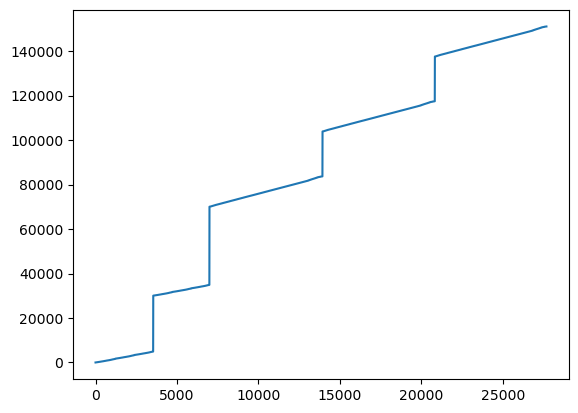

In [4]:
plt.plot(nodeID)

# Read in ML data so we can compare

In [7]:
dataFolder = '/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents'

#read SA data
dfSA = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/actCoords.mat')
sax_ml = dfSA['yAct']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
say_ml = dfSA['xAct']/1e3 #turn into meter
print('ML actuators = ', len(sax_ml), len(say_ml))

#read Afz (Fz influence matrix)
df = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/influenceFunctions.mat')
Afn_ml = df['interactionMat']
fv_ml = df['forceMat'] #fv = fv^T
print('Afn = ',Afn_ml.shape)
print('fv = ', fv_ml.shape)
# this is Afz only; it is 6991 x 170.

#read Fz Bending Mode 
mat = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/SVD.mat')
UMat_ml = mat['U']
SMat_ml = mat['S']
VMat_ml = mat['V']
print('U matrix', UMat_ml.shape)

#read FEA nodes data
mat = scipy.io.loadmat(dataFolder+'/M1 Testing/RFCML Optical Testing/bending modes/nodeCoords.mat')
nodex_ml = mat['y']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
nodey_ml = mat['x']/1e3 #turn into meter
print('N node = ', len(nodex_ml))

############normalize bending modes to RMS = 1um ###################
UMat_ml *= np.sqrt(UMat_ml.shape[0])
for modeID in range(1, UMat_ml.shape[1]+1):
    VMat_ml[:, modeID-1] *= 1e3/SMat_ml[modeID-1, modeID-1]*np.sqrt(UMat_ml.shape[0]) 
    #1e3 due to nanometer to micron conversion; RFCML mode shapes are in nanometers

ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991


Text(0.5, 1.0, 'Actuator IDs and locations in M1-B Coordinate System')

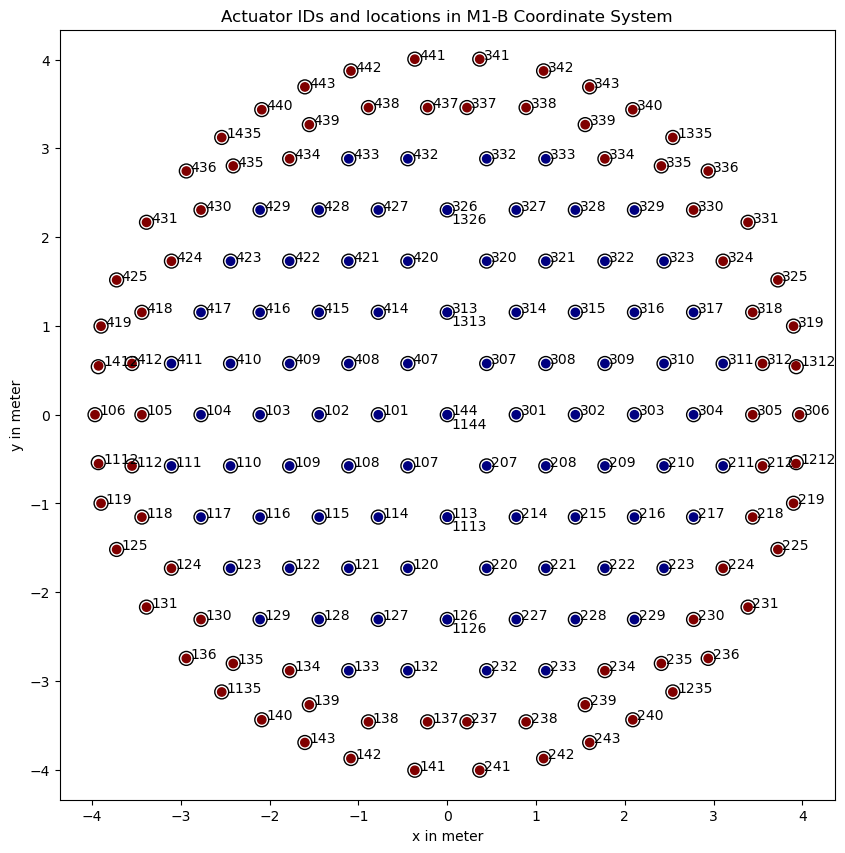

In [5]:
fig, ax = plt.subplots(1,1,figsize=(10,10))
plt.scatter(sax, say, c=saz)
plt.scatter(sax_ml, say_ml, s=100, facecolors='none', edgecolors='k')
for i in range(len(sax)):
    if (np.any(abs(sax[i]+say[i]-sax[:i]-say[:i])<1e-4)):
        plt.text(sax[i]+.05, say[i]-0.15, str(saID[i]))
    else:
        plt.text(sax[i]+.05, say[i], str(saID[i]))
plt.axis('equal')
plt.xlabel('x in meter')
plt.ylabel('y in meter')
plt.title('Actuator IDs and locations in M1-B Coordinate System')
#plt.grid()

In [9]:
#only need to be executed when ID mapping has not been loaded.
saID_ml = np.zeros(len(sax_ml))
sa_offset = np.zeros(len(sax_ml))
for i in range(len(sax_ml)):
    offsetVec = np.hypot(sax_ml[i]-sax, say_ml[i]-say)
    found = np.where(offsetVec<0.1)[0] #less than 0.1meter
    #print(found)
    if len(found)==1:
        offset = offsetVec[found]
        saID_ml[i] = int(saID[found])
    else:
        offset = offsetVec[found[0]]
        saID_ml[i] = saID[found[0]]*1e6+saID[found[1]]
    sa_offset[i] = offset
        #print()
    #else:
    #    print(i, saID[i],sax_ml[i], say_ml[i], found, offset)
    #    print(((abs(sax_ml[i]+say_ml[i]-sax-say)<0.1)))

In [7]:
sax[saID==1112], sax_ml[saID_ml==1112]

(array([-3.92794]), array([[-3.93106656]]))

In [8]:
say[saID==1112], say_ml[saID_ml==1112]

(array([-0.551401]), array([[-0.54024505]]))

In [9]:
plt.scatter(sax_ml, say_ml, .1e5*sa_offset, c=sa_offset)
plt.axis('equal')
plt.colorbar();

NameError: name 'sa_offset' is not defined

In [10]:
saID

array([ 101,  102,  103,  104,  105,  106,  107,  108,  109,  110,  111,
        112,  114,  115,  116,  117,  118,  119,  120,  121,  122,  123,
        124,  125,  127,  128,  129,  130,  131,  132,  133,  134,  135,
        136,  137,  138,  139,  140,  141,  142,  143,  207,  208,  209,
        210,  211,  212,  214,  215,  216,  217,  218,  219,  220,  221,
        222,  223,  224,  225,  227,  228,  229,  230,  231,  232,  233,
        234,  235,  236,  237,  238,  239,  240,  241,  242,  243,  301,
        302,  303,  304,  305,  306,  307,  308,  309,  310,  311,  312,
        314,  315,  316,  317,  318,  319,  320,  321,  322,  323,  324,
        325,  327,  328,  329,  330,  331,  332,  333,  334,  335,  336,
        337,  338,  339,  340,  341,  342,  343,  407,  408,  409,  410,
        411,  412,  414,  415,  416,  417,  418,  419,  420,  421,  422,
        423,  424,  425,  427,  428,  429,  430,  431,  432,  433,  434,
        435,  436,  437,  438,  439,  440,  441,  4

In [11]:
#print out saID_ml
for i in range(len(saID_ml)):
    print('%d'%saID_ml[i], end=' ')
    if i%10==9:
        print()

443 419 143 119 412 112 1435 1135 441 442 
440 436 431 439 425 106 141 142 140 136 
131 139 125 407 420 432 437 414 427 438 
421 433 415 428 422 434 416 429 435 423 
417 430 424 408 409 101 102 410 411 1412 
418 103 104 105 107 120 132 137 114 127 
138 121 133 115 128 122 134 116 129 135 
123 117 130 124 108 109 110 111 1112 118 
144001144 313001313 326001326 113001113 126001126 343 319 243 219 312 
212 1335 1235 341 342 340 336 331 339 325 
306 241 242 240 236 231 239 225 307 320 
332 337 314 327 338 321 333 315 328 322 
334 316 329 335 323 317 330 324 308 309 
301 302 310 311 1312 318 303 304 305 207 
220 232 237 214 227 238 221 233 215 228 
222 234 216 229 235 223 217 230 224 208 
209 210 211 1212 218 

In [12]:
for modeID in range(1,171):
    print(saID2mlModeID(saID[modeID-1]), end= '  ')

46  47  52  53  54  16  55  75  76  77  78  6  59  64  68  72  80  4  56  62  66  71  74  23  60  65  69  73  21  57  63  67  70  20  58  61  22  19  17  18  3  140  160  161  162  163  91  144  149  153  157  165  89  141  147  151  156  159  108  145  150  154  158  106  142  148  152  155  105  143  146  107  104  102  103  88  131  132  137  138  139  101  109  129  130  133  134  90  113  118  122  126  136  87  110  116  120  125  128  100  114  119  123  127  98  111  117  121  124  97  112  115  99  96  94  95  86  24  44  45  48  49  5  28  33  37  41  51  2  25  31  35  40  43  15  29  34  38  42  13  26  32  36  39  12  27  30  14  11  9  10  1  79  8  164  93  135  92  50  7  81  82  83  84  85  81  82  83  84  85  

In [18]:
#only need to be executed when ID mapping has not been loaded.
np.savetxt('saID_ml.txt', saID_ml)

In [19]:
nrow = 15 #take ~2 minutes to run 15 rows
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d'%modeID)

In [21]:
nrow = 15
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(sax, say,80, VMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d, RMS = %.1fN'%(modeID, np.std(VMat[:,modeID-1])))

In [22]:
max(nodeID)

151119.0

# side by side comparison with ML bending modes

In [2]:
from scipy.interpolate import LinearNDInterpolator 
#we interpolate GMT BMs onto ML surface nodes to figure out any sign difference between the two sets of BMs

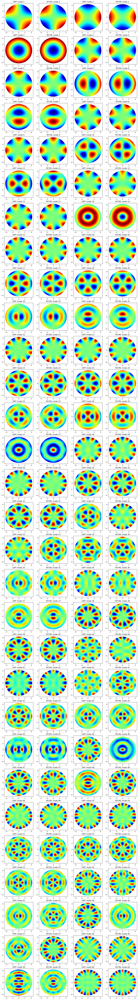

In [14]:
nrow = 30
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,2*nrow+1):
    sign_flip = 1
    interp = LinearNDInterpolator(list(zip(nodex, nodey)), UMat[:, modeID-1], fill_value=0)
    mapOntoML = interp(nodex_ml, nodey_ml).ravel()
    if np.std(mapOntoML+UMat_ml[:,modeID-1])<np.std(UMat_ml[:,modeID-1]):
        sign_flip = -1 #-1 means we need to flip
    #print(sign_flip)
    for j in range(2):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1]*sign_flip)
            ax[irow][icol].set_title('GMT mode %d'%modeID)
        else:
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, UMat_ml[:,modeID-1])
            ax[irow][icol].set_title('RFCML mode %d'%modeID)    

In [4]:
modeID = 1
print(np.sqrt(np.mean((UMat_ml[:,modeID-1])**2)))
print(np.sqrt(np.mean((UMat[:,modeID-1])**2)))
print(np.sqrt(np.mean((VMat_ml[:,modeID-1])**2)))
print(np.sqrt(np.mean((VMat[:,modeID-1])**2)))

0.9999999999999994
0.999999999999996
6.619004334934111
5.550548792388536


In [39]:
xtalk = np.zeros((46, 46))
for i in range(46):
    # method 1 (not good)
    # we pretend ML modes are real BMs. We use GMT BMs to run the tests, 
    # we characterize the xtalk by decomposing each GMT mode onto ML modes.
    # xtalk[i,j] is the ith coeff when jth ML mode is decomposed onto all GMT modes.
    #for BM#1, GMT says 5.6N RMS is needed to get 1um BM. ML says no, 6.6N. 
    #ML mode is stiffer. same force = less surf RMS bend. we want this to show up as xtalk[0,0]<1
    # PROBLEM: some modes diff by mostly a rotation angle. These show up as off-diagonal elements
    
    #interp = LinearNDInterpolator(list(zip(nodex, nodey)), UMat[:, i], fill_value=0)
    #mapOntoML = interp(nodex_ml, nodey_ml).ravel()
    #aa = UMat_ml.transpose() /UMat_ml.shape[0] @ mapOntoML
    #xtalk[:,i] = np.abs(aa[:46]) #sometimes the signs are reversed by ML and GMT
    
    #method 2
    # use ML influence matrix, multiple with GMT BM forces, get the mode shapes, decompose onto GMT BMs.
    #1e-3 due to nanometer to micron conversion; RFCML mode shapes are in nanometers
    ss_mlgrid = Afn_ml @ gmtFvec2mlFvec(VMat[:,i]) * 1e-3
    interp = LinearNDInterpolator(list(zip(np.squeeze(nodex_ml), np.squeeze(nodey_ml))), ss_mlgrid, fill_value=0)
    mapOntoGMT = interp(nodex, nodey).ravel()
    aa = UMat.transpose() / UMat.shape[0] @ mapOntoGMT
    xtalk[:, i] = aa[:46]

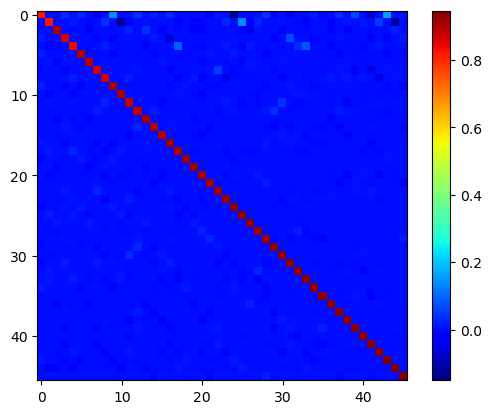

In [40]:
plt.imshow(xtalk)
plt.colorbar();

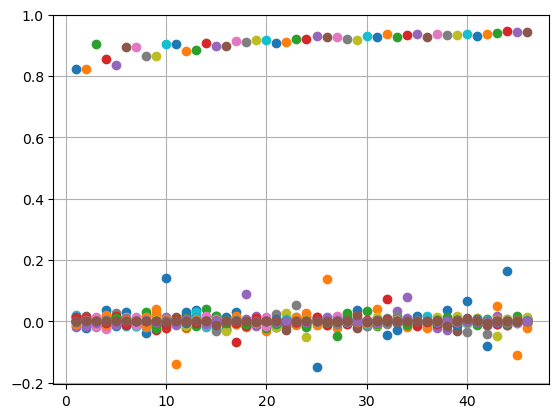

In [44]:
plt.plot(range(1,47),xtalk.transpose(),'o');
plt.grid();

## GMT single SA IF (influenceMat * [0 0 1 0 0 ... 0])

In [6]:
TR_IDs = np.loadtxt('SA_ID_for_IF.txt')

In [8]:
idx = np.zeros(nact)
for ii in range(nact):
    if saID[ii] in TR_IDs:
        if saz[ii]>0.04:
            idx[ii] = 1
        else:
            idx[ii] = 3

In [10]:
sax[idx!=0]

array([-1.77548, -2.93919,  1.77548,  2.93919,  1.77547,  2.93908,
       -1.77548, -2.93908,  0.     ,  0.     ,  0.     ,  0.     ,
        0.     ,  0.     ,  0.     ,  0.     ,  0.     ,  0.     ])

Text(0.5, 1.0, 'Actuator IDs and locations in M1-B Coordinate System')

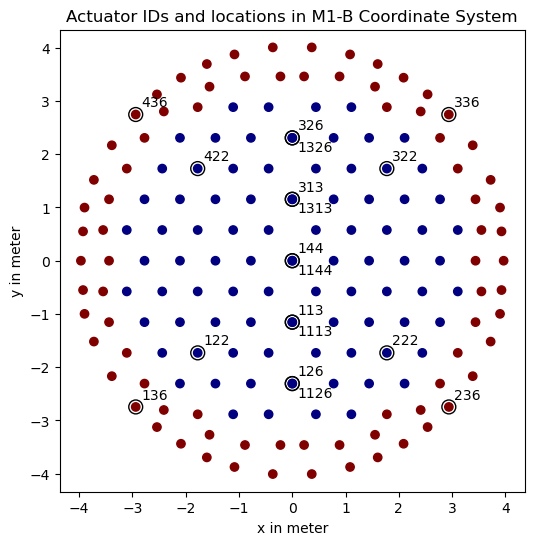

In [16]:
fig, ax = plt.subplots(1,1,figsize=(6,6))
plt.scatter(sax, say, c=saz)
plt.scatter(sax[idx!=0], say[idx!=0], s=100, facecolors='none', edgecolors='k')
for i in range(len(sax)):
    if idx[i] != 0:
        if (np.any(abs(sax[i]+say[i]-sax[:i]-say[:i])<1e-4)):
            plt.text(sax[i]+.1, say[i]-0.25, str(saID[i]))
        else:
            plt.text(sax[i]+.1, say[i]+0.15, str(saID[i]))
plt.axis('equal')
plt.xlabel('x in meter')
plt.ylabel('y in meter')
plt.title('Actuator IDs and locations in M1-B Coordinate System')

In [17]:
Afz.shape

(27685, 170)

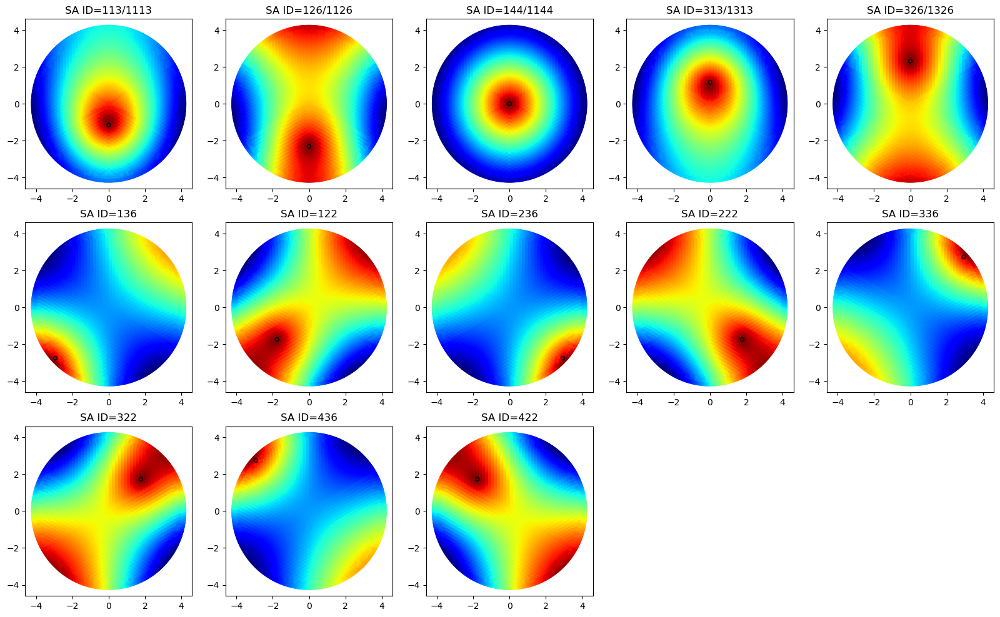

In [26]:
nrow = 3
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for mysaID in TR_IDs:

    if mysaID < 1000:
        modeID = np.argmax(saID==mysaID)+1
        irow = np.int8(i/5)
        icol = np.mod(i,5)
        i += 1

        img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
        if mysaID in TR_IDs[:10]:
            ax[irow][icol].set_title('SA ID=%d/%d'%(saID[modeID-1], saID[modeID-1]+1000))
        else:
            ax[irow][icol].set_title('SA ID=%d'%(saID[modeID-1]))
        circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
        ax[irow][icol].add_artist(circle)
endMode = i
for i in range(endMode, nrow*5):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    ax[irow][icol].axis('off')

In [22]:
i

13

## Side by side comparison with ML single SA IF

In [28]:
IF_ml = Afn_ml @ fv_ml

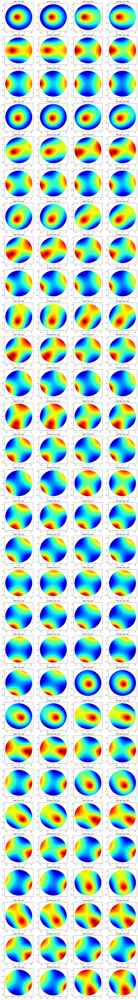

In [29]:
nrow = 30
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,2*nrow+1):
    for j in range(2):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
            ax[irow][icol].set_title('GMT SA %d'%saID[modeID-1])
            circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)
        else:
            modeID_ml = saID2mlModeID(saID[modeID-1]) #we want modeID_ml to start from 1 as well
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, IF_ml[:,modeID_ml-1])
            ax[irow][icol].set_title('RFCML SA %d'%saID_ml[modeID_ml-1])   
            circle = plt.Circle((sax_ml[modeID_ml-1], say_ml[modeID_ml-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)